## Problem Statement: 
Finding the best airfare has been desired by everyone but not always available to all. In this project we will try to predict the best airfare based on historical data.

## Data Understanding
To understand the pattern of air fare, we have a dataset derived from publicly available sources provided by the US Department of Transportation Bureau of Transportation Statistics (BTS). It combines and processes data from two major sources — the DB1B and T-100 datasets. Along with cleaned BTS data, the dataset features additional variables that help explain fare differences across markets, such as competition intensity, circuity and existence of multiple airports within the origin, destination, or both.

## Objectives
Understand the relationship between various features and average airfare.
Build and evaluate multiple regression models to predict the best average airfare.
Provide actionable insights based on model findings.


In [2]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.metrics import mean_squared_error, r2_score

In [4]:
# Load the dataset
df = pd.read_csv('data/MarketFarePredictionData.csv')
df.head()

,MktCoupons,OriginCityMarketID,DestCityMarketID,OriginAirportID,DestAirportID,Carrier,NonStopMiles,RoundTrip,ODPairID,Pax,...,Circuity,Slot,Non_Stop,MktMilesFlown,OriginCityMarketID_freq,DestCityMarketID_freq,OriginAirportID_freq,DestAirportID_freq,Carrier_freq,ODPairID_freq
0,2,178,152,170,255,6,1807.0,1.0,4035,136.0,...,1.367460,0,0.0,1992.449761,0.004138,0.039783,0.004138,0.022049,0.116826,0.000132
1,2,178,152,170,194,20,1798.0,1.0,4035,136.0,...,1.051724,0,0.0,1992.449761,0.004138,0.039783,0.004138,0.008368,0.307651,0.000132
2,2,178,152,170,260,6,1784.0,0.0,4035,136.0,...,1.034753,0,0.0,1992.449761,0.004138,0.039783,0.004138,0.009366,0.116826,0.000132
3,2,178,152,170,255,6,1807.0,1.0,4035,136.0,...,1.029884,0,0.0,1992.449761,0.004138,0.039783,0.004138,0.022049,0.116826,0.000132
4,2,178,152,170,194,20,1798.0,1.0,4035,136.0,...,1.062291,0,0.0,1992.449761,0.004138,0.039783,0.004138,0.008368,0.307651,0.000132


## Exploratory Data Analysis (EDA)

In [7]:
# Display basic information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1581278 entries, 0 to 1581277
Data columns (total 26 columns):
 #   Column                   Non-Null Count    Dtype  
---  ------                   --------------    -----  
 0   MktCoupons               1581278 non-null  int64  
 1   OriginCityMarketID       1581278 non-null  int64  
 2   DestCityMarketID         1581278 non-null  int64  
 3   OriginAirportID          1581278 non-null  int64  
 4   DestAirportID            1581278 non-null  int64  
 5   Carrier                  1581278 non-null  int64  
 6   NonStopMiles             1581278 non-null  float64
 7   RoundTrip                1581278 non-null  float64
 8   ODPairID                 1581278 non-null  int64  
 9   Pax                      1581278 non-null  float64
 10  CarrierPax               1581278 non-null  float64
 11  Average_Fare             1581278 non-null  float64
 12  Market_share             1581278 non-null  float64
 13  Market_HHI               1581278 non-null 

In [9]:
# Display descriptive statistics
df.describe()

,MktCoupons,OriginCityMarketID,DestCityMarketID,OriginAirportID,DestAirportID,Carrier,NonStopMiles,RoundTrip,ODPairID,Pax,...,Circuity,Slot,Non_Stop,MktMilesFlown,OriginCityMarketID_freq,DestCityMarketID_freq,OriginAirportID_freq,DestAirportID_freq,Carrier_freq,ODPairID_freq
count,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,...,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06,1.581278e+06
mean,1.179463e+00,1.081836e+02,1.088161e+02,1.483760e+02,1.492537e+02,1.277755e+01,1.183158e+03,8.052215e-01,2.488494e+03,1.773202e+05,...,1.026428e+00,1.213386e-01,8.220598e-01,1.213717e+03,2.654614e-02,2.652975e-02,1.657893e-02,1.658640e-02,1.527605e-01,7.775990e-04
std,3.876878e-01,6.779829e+01,6.824662e+01,7.974261e+01,8.006476e+01,7.785476e+00,7.136535e+02,3.960302e-01,1.401771e+03,2.380289e+05,...,1.091917e-01,3.265204e-01,3.824626e-01,7.268271e+02,1.934480e-02,1.924849e-02,1.008668e-02,1.007899e-02,1.119035e-01,9.117999e-04
min,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+02,0.000000e+00,0.000000e+00,1.000000e+00,...,1.000000e+00,0.000000e+00,0.000000e+00,1.020000e+02,4.426799e-06,2.529599e-06,4.426799e-06,2.529599e-06,3.958823e-04,6.323999e-07
25%,1.000000e+00,4.800000e+01,4.800000e+01,7.300000e+01,7.400000e+01,4.000000e+00,6.430000e+02,1.000000e+00,1.349000e+03,3.182400e+04,...,1.000000e+00,0.000000e+00,1.000000e+00,6.580258e+02,1.037452e-02,1.050922e-02,8.544355e-03,8.631626e-03,5.086329e-02,2.093244e-04
50%,1.000000e+00,1.070000e+02,1.080000e+02,1.500000e+02,1.510000e+02,1.500000e+01,1.011000e+03,1.000000e+00,2.598000e+03,8.654300e+04,...,1.000000e+00,0.000000e+00,1.000000e+00,1.040641e+03,2.645202e-02,2.620602e-02,1.636777e-02,1.672128e-02,1.168264e-01,4.648139e-04
75%,1.000000e+00,1.580000e+02,1.590000e+02,2.130000e+02,2.140000e+02,2.000000e+01,1.590000e+03,1.000000e+00,3.493000e+03,2.318210e+05,...,1.000000e+00,0.000000e+00,1.000000e+00,1.639106e+03,3.978681e-02,3.978301e-02,2.324512e-02,2.335263e-02,3.076512e-01,1.035239e-03
max,3.000000e+00,2.660000e+02,2.670000e+02,2.900000e+02,2.910000e+02,2.400000e+01,5.095000e+03,1.000000e+00,5.354000e+03,1.495396e+06,...,2.985825e+00,1.000000e+00,1.000000e+00,5.096521e+03,6.692372e-02,6.629195e-02,3.630165e-02,3.597090e-02,3.076512e-01,5.302673e-03


In [11]:
# Check for missing values
df.isnull().sum()

MktCoupons                 0
OriginCityMarketID         0
DestCityMarketID           0
OriginAirportID            0
DestAirportID              0
Carrier                    0
NonStopMiles               0
RoundTrip                  0
ODPairID                   0
Pax                        0
CarrierPax                 0
Average_Fare               0
Market_share               0
Market_HHI                 0
LCC_Comp                   0
Multi_Airport              0
Circuity                   0
Slot                       0
Non_Stop                   0
MktMilesFlown              0
OriginCityMarketID_freq    0
DestCityMarketID_freq      0
OriginAirportID_freq       0
DestAirportID_freq         0
Carrier_freq               0
ODPairID_freq              0
dtype: int64

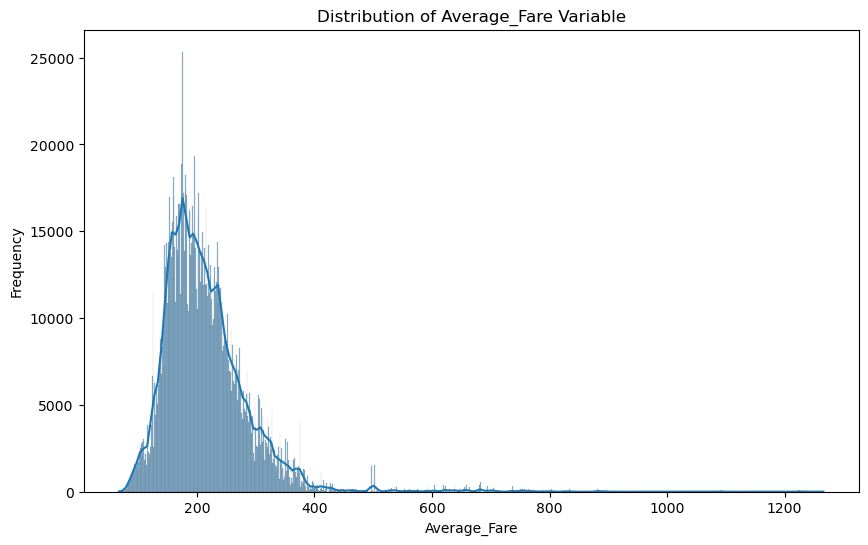

In [13]:
# Visualize the distribution of the target variable
plt.figure(figsize=(10, 6))
sns.histplot(df['Average_Fare'], kde=True)
plt.title('Distribution of Average_Fare Variable')
plt.xlabel('Average_Fare')
plt.ylabel('Frequency')
plt.show()
     


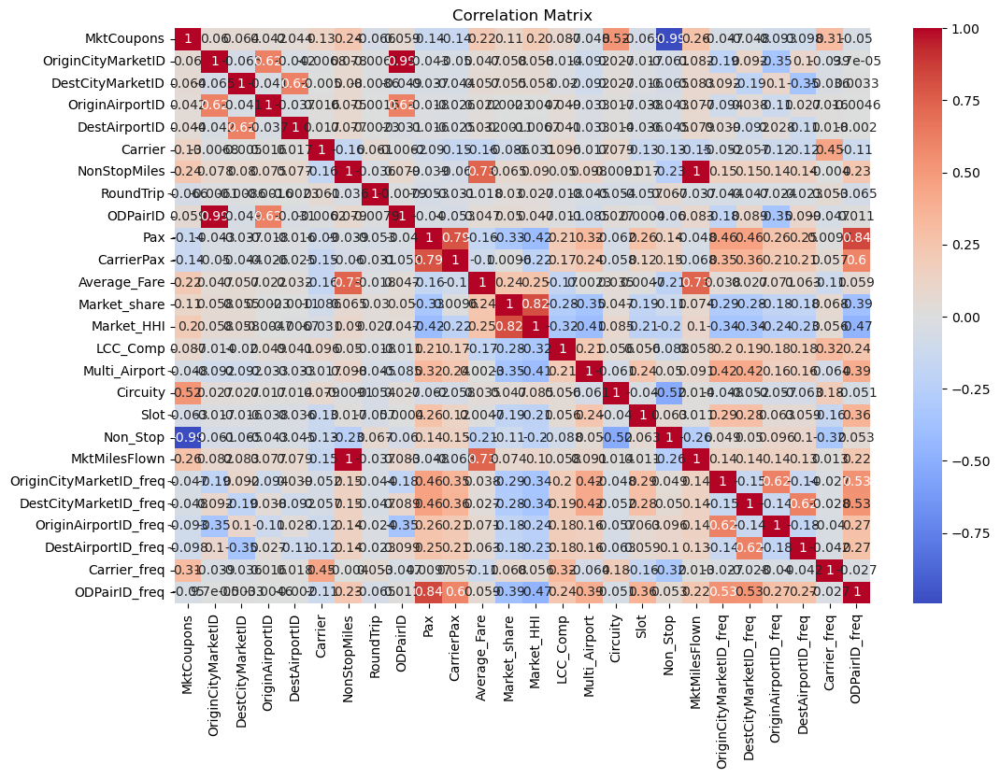

In [15]:
# Visualize correlations
plt.figure(figsize=(12, 8))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

## Lets have a little better visulization by ignoring columns having no corelation data

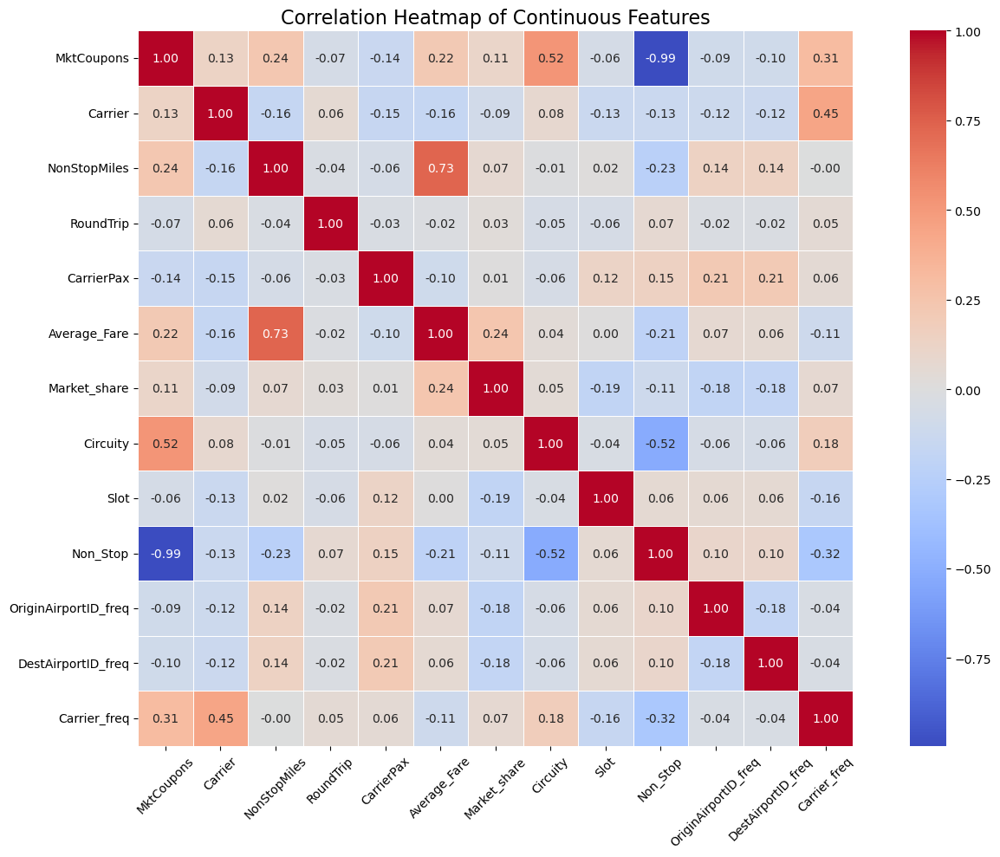

In [18]:
# --- Correlation Heatmap of Continuous Features ---
# Select only continuous numeric columns (excluding IDs, categorical flags, etc.)
continuous_cols = [
    'MktCoupons', 'Carrier', 'NonStopMiles', 'RoundTrip', 'CarrierPax', 'Average_Fare', 'Market_share', 'Circuity', 'Slot', 'Non_Stop',
    'OriginAirportID_freq', 'DestAirportID_freq', 'Carrier_freq'
]

plt.figure(figsize=(14, 10))
corr_matrix = df[continuous_cols].corr()

sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', linewidths=0.5, square=True)
plt.title('Correlation Heatmap of Continuous Features', fontsize=16)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


## Data cleaning
No data cleaning is required.

## Split dataset into train, test
Spliting a route specific data to 80:20.


In [21]:
X = df.drop('Average_Fare', axis=1)
y = df['Average_Fare']

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

In [23]:
# Initialize models
models = {
    'Linear Regression': LinearRegression(),
    'Ridge Regression': Ridge(),
    'Lasso Regression': Lasso(),
    'Elastic Net Regression': ElasticNet(),
}

In [25]:
# Train and evaluate models
results = {}
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    r2 = r2_score(y_test, y_pred)
    results[name] = {'RMSE': rmse, 'R2': r2}
    print(f"{name}: RMSE = {rmse:.4f}, R2 = {r2:.4f}")

Linear Regression: RMSE = 44.7069, R2 = 0.6276
Ridge Regression: RMSE = 44.7069, R2 = 0.6276
Lasso Regression: RMSE = 45.1675, R2 = 0.6199
Elastic Net Regression: RMSE = 46.6472, R2 = 0.5946


**Linear and Ridge Regression** has the best performance among the four models with the lowest RMSE and the highest R2 value. It is the most suitable model for this dataset based on the given metrics.

**RMSE (Root Mean Squared Error) = 44.7069:** This value indicates the average error in the predictions. In this context, it means that on average, the model's predictions are off by about 44.71 units from the actual values of average fare.

**R2 (R-squared) = 0.6276:** This value indicates that approximately 62.76% of the variance in the target variable (average fare) is explained by the features in the model. While this is a moderate level of explanation, it also indicates that there is still a significant amount of unexplained variance, suggesting room for model improvement.

## Cross Validation and Hyperparameter Tuning

In [59]:
# Define the parameter grid for Ridge, Lasso, and Elastic Net
param_grid = {
    'Ridge': {'alpha': [0.1, 1.0, 10.0, 100.0]}
}

# Initialize the models
models = {
    'Linear Regression': LinearRegression(),
    'Ridge': Ridge()
}

# Perform cross-validation and hyperparameter tuning
best_models = {}
for name, model in models.items():
    if name in param_grid:
        grid = GridSearchCV(model, param_grid[name], cv=5, scoring='neg_mean_squared_error')
        grid.fit(X_train, y_train)
        best_models[name] = grid.best_estimator_
        best_rmse = np.sqrt(-grid.best_score_)
        print(f"Best {name}: {grid.best_params_}, RMSE = {best_rmse:.4f}")
    else:
        # For Linear Regression, just perform cross-validation
        scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
        rmse_scores = np.sqrt(-scores)  # Convert negative MSE to RMSE
        best_models[name] = model
        print(f"{name}: Cross-validation RMSE = {rmse_scores.mean():.4f}")

print()
print('Evaluate the best models on the test set')
results = {}
for name, model in best_models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    rmse = mse ** 0.5
    r2 = r2_score(y_test, y_pred)
    results[name] = {'RMSE': rmse, 'R2': r2}
    print(f"{name}: RMSE = {rmse:.4f}, R2 = {r2:.4f}")

Linear Regression: Cross-validation RMSE = 44.8029
Best Ridge: {'alpha': 1.0}, RMSE = 44.8032

Evaluate the best models on the test set
Linear Regression: RMSE = 44.7069, R2 = 0.6276
Ridge: RMSE = 44.7069, R2 = 0.6276


**The performance remains mostly unchanged** as expected since Linear Regression does not have hyperparameters to tune. It serves as a baseline for comparison.

Based on the post-tuning metrics, **Linear Regression is the best performing model** with the lowest RMSE and highest R2 score, making it the preferred choice for predicting average fare in this context.



## Linear Regression model - Final performance metrics and model interpretation

Given the results of the previous section, we'll proceed with the best Linear regression model for further analysis.


In [76]:
# Use the best Linear regression model to make predictions
best_model = best_models['Ridge']
y_pred = best_model.predict(X_test)

# Create a DataFrame to show actual vs. predicted values
actual_vs_predicted_df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
actual_vs_predicted_df.head(10)


,Actual,Predicted
115482,207.44,239.483048
1346404,266.08,258.644334
1166331,197.02,208.946350
540157,138.88,145.957421
245966,306.59,305.073261
1154373,211.46,289.868208
880342,241.52,255.546152
65962,154.83,168.798415
715552,267.16,285.399760
268533,253.66,212.479533


## Interpret the Coefficients and Y-Intercept

Linear regression provides the coefficients of the features and the intercept. These values help us understand the relationship between each feature and the target variable. However, due to the L1 regularization, some coefficients may be zero, indicating that the feature is not used in the model.

In [82]:
# Get the coefficients and the intercept from the Linear Regression model
X_train_df=pd.DataFrame(X_train, columns=['MktCoupons','OriginCityMarketID','DestCityMarketID','OriginAirportID','DestAirportID','Carrier',
                                          'NonStopMiles','RoundTrip','ODPairID','Pax','CarrierPax','Market_share','Market_HHI','LCC_Comp',
                                          'Multi_Airport','Circuity','Slot','Non_Stop','MktMilesFlown','OriginCityMarketID_freq',
                                          'DestCityMarketID_freq','OriginAirportID_freq','DestAirportID_freq','Carrier_freq','ODPairID_freq']
                       )

coefficients = pd.Series(best_model.coef_, index=X_train_df.columns)
intercept = best_model.intercept_

print("Linear Regression Coefficients:")
print(coefficients)
print("\nIntercept:", intercept)

Linear Regression Coefficients:
MktCoupons                 13.147811
OriginCityMarketID          0.904572
DestCityMarketID           -0.073402
OriginAirportID            -1.127701
DestAirportID              -0.878606
Carrier                     2.526193
NonStopMiles               39.983779
RoundTrip                   0.703659
ODPairID                   -1.434764
Pax                       -16.709535
CarrierPax                  5.971353
Market_share                7.394271
Market_HHI                  4.665953
LCC_Comp                  -11.131410
Multi_Airport               2.914628
Circuity                    2.088194
Slot                        2.759327
Non_Stop                    8.975253
MktMilesFlown               9.893920
OriginCityMarketID_freq    -4.174969
DestCityMarketID_freq      -4.846638
OriginAirportID_freq        5.003250
DestAirportID_freq          5.274419
Carrier_freq               -7.378940
ODPairID_freq              11.502694
dtype: float64

Intercept: 214.446690759514

## In general:

**Coefficient Value:** The value of each coefficient represents the expected change in the target variable for a one-unit change in the corresponding feature, assuming all other features remain constant.

**Intercept:** The intercept represents the expected value of the target variable when all features are zero.


## Plot the results

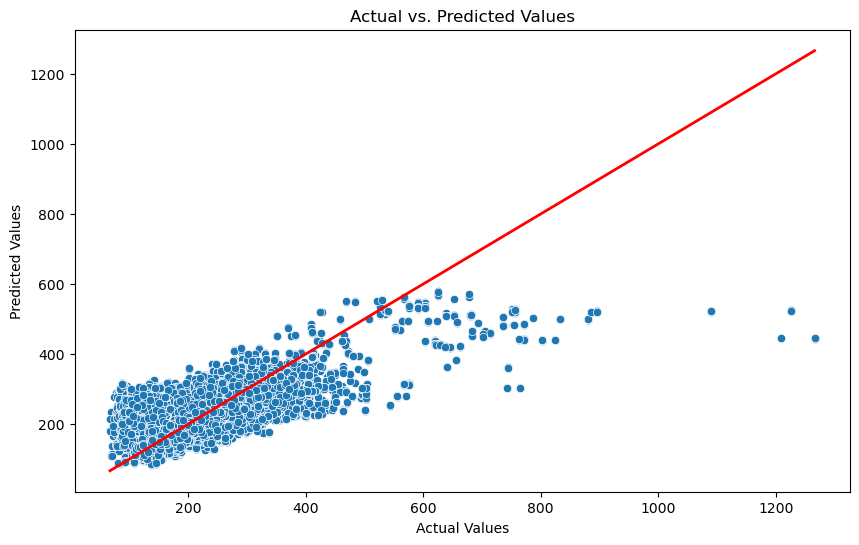

In [85]:
# Plot actual vs. predicted values
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Actual', y='Predicted', data=actual_vs_predicted_df)
plt.plot([actual_vs_predicted_df['Actual'].min(), actual_vs_predicted_df['Actual'].max()],
         [actual_vs_predicted_df['Actual'].min(), actual_vs_predicted_df['Actual'].max()],
         color='red', linewidth=2)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs. Predicted Values')
plt.show()

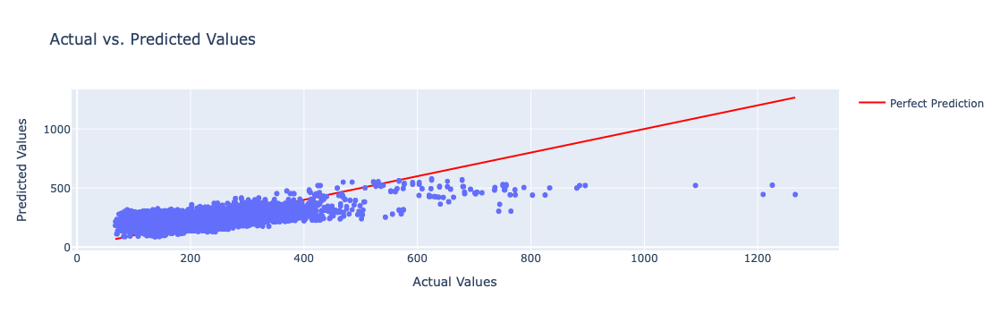

In [87]:
# Plot actual vs. predicted values

# Create scatter plot
fig = px.scatter(
    actual_vs_predicted_df,
    x='Actual',
    y='Predicted',
    title='Actual vs. Predicted Values',
    labels={'Actual': 'Actual Values', 'Predicted': 'Predicted Values'}
)

# Add a line for perfect predictions
fig.add_trace(
    go.Scatter(
        x=[actual_vs_predicted_df['Actual'].min(), actual_vs_predicted_df['Actual'].max()],
        y=[actual_vs_predicted_df['Actual'].min(), actual_vs_predicted_df['Actual'].max()],
        mode='lines',
        name='Perfect Prediction',
        line=dict(color='red', width=2)
    )
)

# Save the plot as an HTML file
fig.write_html("actual_vs_predicted.html")

# To display the plot (optional)
fig.show()

## Conclusions
Based on above model **Non Stop flights** has the maximum impact on average fare. Next comes the **Airline** operating frequency on the selected route. **Time slot** also adds up significant into average fare, more desirable slots typically cost more money.
